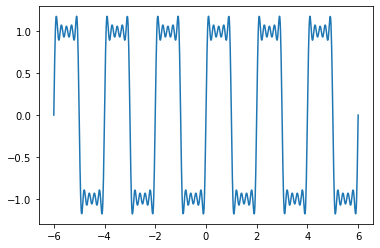

In [1]:
# Fourier Basico
import numpy as np
import matplotlib.pyplot as plt

def fourier_sum(n, L, x):
    f_sum = np.zeros(len(x))
    for i in range(1, n+1):
        f_sum += (2/(i*np.pi))*(1 - (-1)**i)*np.sin((i*np.pi*x)/L)
    return f_sum

L_value = 1

x_plot = np.linspace(-6, 6, 1000)
y_plot = fourier_sum(10, L_value, x_plot)


plt.plot(x_plot, y_plot)

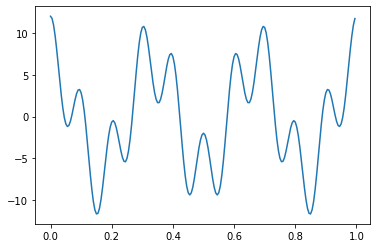

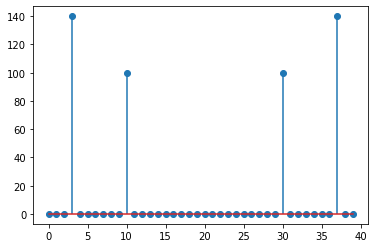

In [3]:
#Fourier Discreto
def DFT_lenta(x):
    x = np.array(x) ### linspace en el tiempo
    N = x.shape[0]
    ns = np.arange(N).reshape(-1, 1)
    ks = np.arange(N)
    return np.exp(-2.0j*np.pi*ns*ks / N) @ x

def obtener_frecuencias_y_amplitudes(f, N):
    #t = np.arange(0, 2*np.pi, (2*np.pi)/N)
    t = np.arange(0, 1, 1/N)
    x = f(t)
    X = DFT_lenta(x)
    return np.arange(N), np.abs(X)
    
def f(t):
    # return 7*np.sin((3)*t) + 5*np.sin((10)*t)
    return 7*np.cos((2*np.pi)*(3)*t) + 5*np.cos((2*np.pi)*(10)*t)
N = 200
t = np.arange(0, 1, 1/N)
plt.plot(t, f(t))
plt.show()
N = 40
frecs, amps = obtener_frecuencias_y_amplitudes(f, N)

plt.stem(frecs, amps, use_line_collection = True)
plt.show()


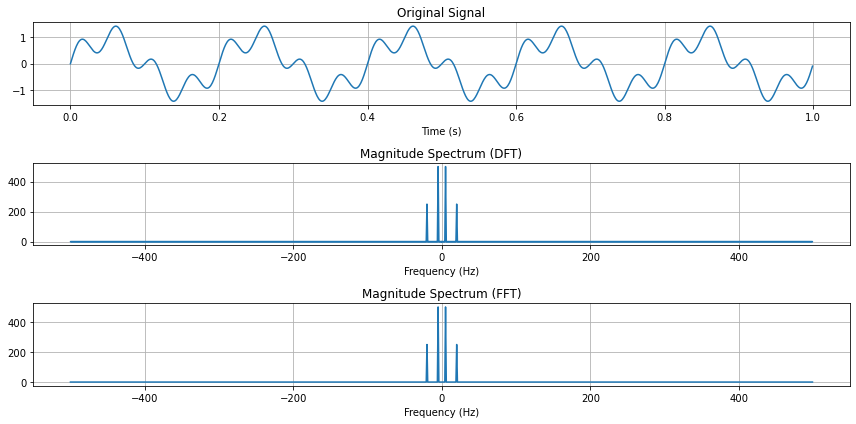

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Create a time-domain signal
fs = 1000  # Sampling frequency (Hz)
T = 1.0    # Duration of the signal (s)
t = np.linspace(0.0, T, int(T * fs), endpoint=False)  # Time vector

# Create a composite signal with two sinusoidal components
frequencies = [5, 20]  # Frequencies of the sinusoidal components (Hz)
amplitudes = [1.0, 0.5]  # Amplitudes of the sinusoidal components
signal = np.sum([amp * np.sin(2 * np.pi * freq * t) for freq, amp in zip(frequencies, amplitudes)], axis=0)

# Compute the Discrete Fourier Transform (DFT)
dft = np.fft.fft(signal)
freq = np.fft.fftfreq(len(t), 1/fs)

# Compute the magnitude spectrum (absolute values of DFT)
magnitude_spectrum = np.abs(dft)

# Compute the Fast Fourier Transform (FFT)
fft = np.fft.fftshift(np.fft.fft(signal))
freq_fft = np.fft.fftshift(np.fft.fftfreq(len(t), 1/fs))

# Plot the original signal
plt.figure(figsize=(12, 6))
plt.subplot(3, 1, 1)
plt.plot(t, signal)
plt.title('Original Signal')
plt.xlabel('Time (s)')
plt.grid(True)

# Plot the magnitude spectrum (DFT)
plt.subplot(3, 1, 2)
plt.plot(freq, magnitude_spectrum)
plt.title('Magnitude Spectrum (DFT)')
plt.xlabel('Frequency (Hz)')
plt.grid(True)

# Plot the magnitude spectrum (FFT)
plt.subplot(3, 1, 3)
plt.plot(freq_fft, np.abs(fft))
plt.title('Magnitude Spectrum (FFT)')
plt.xlabel('Frequency (Hz)')
plt.grid(True)

plt.tight_layout()
plt.show()


t = 1.0    err euler = 0.000000
t = 1.1    err euler = 0.012756
t = 1.2    err euler = 0.026667
t = 1.3    err euler = 0.041883
t = 1.4    err euler = 0.058557
t = 1.5    err euler = 0.076849


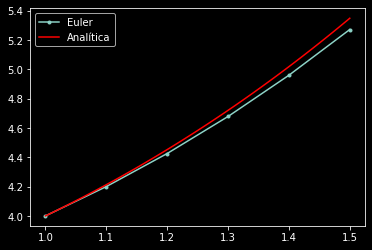

In [12]:
#Metodos numericos de solucion
#Regla de Euler
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('dark_background')
def regla_euler(f, y0, t0, tf, h):
  ys = [y0]
  for t in np.arange(t0, tf, h):
    y1 = y0 + h * f(t, y0)
    ys.append(y1)
    y0 = y1
  return np.linspace(t0,tf,len(ys)), np.array(ys)
def f_torricelli(t,y):
  gravity = 9.8
  return -(np.sqrt(gravity)/2)*np.sqrt(y)

def f(t,y):
  return t*np.sqrt(y)

def sol_analitica_torricelli(t):
  gravity = 9.8
  h_0 = 16
  return (np.sqrt(h_0) - (np.sqrt(gravity)/4)*t)**2

def sol_analitica(t):
  return ((t*t + 7)**2)/16

def imprimir_resultados_euler(t,y,f_sol):
  err_euler = np.abs(f_sol(t)-y)
  for i in range(len(t)):
    print('t = %3.1f    err euler = %f' % (t[i], err_euler[i]))

def grafica_comparativa(t, y_euler, f_sol):
  t_sol = np.linspace(t[0], t[-1], 101)
  plt.plot(t, y_euler, '.-', label = 'Euler')
  plt.plot(t_sol, f_sol(t_sol), 'r', label = 'Analítica')
  plt.legend()

y0 = 4
t0 = 1
tf = 1.5
h = 0.1

t, y_euler = regla_euler(f, y0, t0, tf, h)
imprimir_resultados_euler(t,y_euler,sol_analitica)
grafica_comparativa(t, y_euler, sol_analitica)

t = 0.0   err euler = 1.062500   err rk4 = 1.062500
t = 0.5   err euler = 1.285156   err rk4 = 1.108380
t = 1.0   err euler = 1.646447   err rk4 = 1.239924
t = 1.5   err euler = 2.227038   err rk4 = 1.461646
t = 2.0   err euler = 3.116986   err rk4 = 1.779186
t = 2.5   err euler = 4.418704   err rk4 = 2.198480
t = 3.0   err euler = 6.245962   err rk4 = 2.725305
t = 3.5   err euler = 8.721400   err rk4 = 3.365040
t = 4.0   err euler = 11.974030   err rk4 = 4.122582


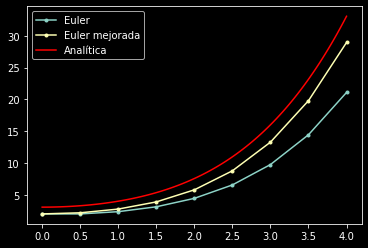

In [15]:
#Euler mejorado
def regla_euler_mejorada(f, y0, t0, tf, h):
  ys = [y0]
  h_medios = h*0.5
  for t in np.arange(t0, tf, h):
    k1 = h_medios * f(t, y0)
    k2 = h_medios * f(t + h, y0 + 2*k1)
    y1 = y0 + k1 + k2
    ys.append(y1)
    y0 = y1
  return np.linspace(t0,tf,len(ys)), np.array(ys)
def f(t,y):
  return t*np.sqrt(y)

def sol_analitica(t):
  return ((t*t + 7)**2)/16

def grafica_comparativa(t, y_euler, y_rk4, f_sol):
  t_sol = np.linspace(t[0], t[-1], 101)
  plt.plot(t, y_euler, '.-', label = 'Euler')
  plt.plot(t, y_euler_mejorada, '.-', label = 'Euler mejorada')
  plt.plot(t_sol, f_sol(t_sol), 'r', label = 'Analítica')
  plt.legend()

def imprimir_error(t, y_euler, y_rk4, f_sol):
  err_euler = np.abs(y_euler - f_sol(t))
  err_rk4 = np.abs(y_euler_mejorada - f_sol(t))
  for i in range(len(t)):
    text = 't = %3.1f   err euler = %f   err rk4 = %f'
    print(text % (t[i],err_euler[i],err_rk4[i]))

y0 = 2.0
t0 = 0.0
tf = 4.0
h = 0.5

t, y_euler = regla_euler(f, y0, t0, tf, h)
t, y_euler_mejorada = regla_euler_mejorada(f, y0, t0, tf, h)
imprimir_error(t[:], y_euler, y_euler_mejorada, sol_analitica)
grafica_comparativa(t, y_euler, y_euler_mejorada, sol_analitica)

t = 0.0   err euler = 0.000000   err rk4 = 0.000000
t = 0.5   err euler = 0.080856   err rk4 = 0.000240
t = 1.0   err euler = 0.397099   err rk4 = 0.000397
t = 1.5   err euler = 1.067932   err rk4 = 0.001135
t = 2.0   err euler = 2.047517   err rk4 = 0.002891
t = 2.5   err euler = 2.481220   err rk4 = 0.004281
t = 3.0   err euler = 2.076853   err rk4 = 0.005483
t = 3.5   err euler = 2.155869   err rk4 = 0.006870
t = 4.0   err euler = 3.461592   err rk4 = 0.008667


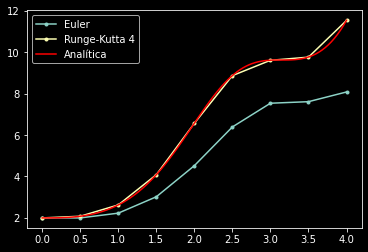

In [17]:
#Rugen Kutta 4to orden
def runge_kutta_cuarto_orden(f, y0, t0, tf, h):
  ys = [y0]
  h_medios = h*0.5
  un_sexto = 1.0 / 6.0
  for t in np.arange(t0, tf, h):
    k1 = h * f(t, y0)
    k2 = h * f(t + h_medios, y0 + k1*0.5)
    k3 = h * f(t + h_medios, y0 + k2*0.5)
    k4 = h * f(t + h, y0 + k3)
    y1 = y0 + un_sexto*(k1 + 2*k2 + 2*k3 + k4)
    ys.append(y1)
    y0 = y1
  return np.linspace(t0,tf,len(ys)), np.array(ys)
def f(t,y):
  return y*np.sin(t)**2

def sol_analitica(t):
  return 2* np.exp(0.5*(t - np.sin(t)*np.cos(t)))

def grafica_comparativa(t, y_euler, y_rk4, f_sol):
  t_sol = np.linspace(t[0], t[-1], 101)
  plt.plot(t, y_euler, '.-', label = 'Euler')
  plt.plot(t, y_rk4, '.-', label = 'Runge-Kutta 4')
  plt.plot(t_sol, f_sol(t_sol), 'r', label = 'Analítica')
  plt.legend()

def imprimir_error(t, y_euler, y_rk4, f_sol):
  err_euler = np.abs(y_euler - f_sol(t))
  err_rk4 = np.abs(y_rk4 - f_sol(t))
  for i in range(len(t)):
    text = 't = %3.1f   err euler = %f   err rk4 = %f'
    print(text % (t[i],err_euler[i],err_rk4[i]))

y0 = 2.0
t0 = 0.0
tf = 4.0
h = 0.5

t, y_euler = regla_euler(f, y0, t0, tf, h)
t, y_rk4 = runge_kutta_cuarto_orden(f, y0, t0, tf, h)
imprimir_error(t[:], y_euler, y_rk4, sol_analitica)
grafica_comparativa(t, y_euler, y_rk4, sol_analitica)

Animation size has reached 21006421 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


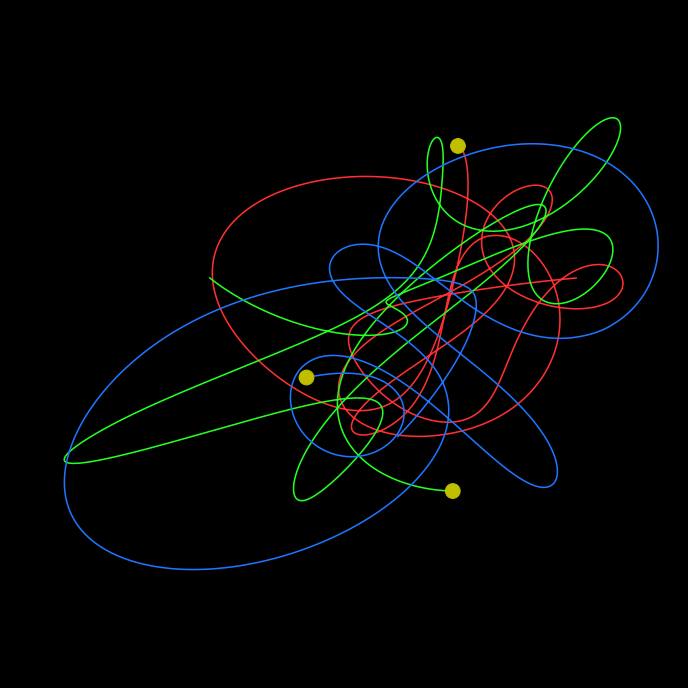

In [19]:
#Ruggen Kutta 8vo orden
import time
import numpy as np
import scipy as sci
import scipy.integrate as integrate

import matplotlib.pyplot as plt
from matplotlib import animation
plt.style.use('dark_background')

from matplotlib import rc
rc("animation", html = "jshtml")

#Constante de gravitación universal
G = 6.67408e-11 # m^3 / (s^2 kg)

#cantidades de referencia
masa_ref = 1.989e+30 # kg
dist_ref = 5.326e+12 # m
velo_ref = 30000 # m/s
time_ref = 400*365*24*3600 # s

#masas
m1 = 1.1 
m2 = 0.907 
m3 = 1.0 

#posiciones iniciales
r1 = np.array([-0.5, 0.0, 0.0])
r2 = np.array([ 0.5, 0.0, 0.0])
r3 = np.array([ 0.0, 1.0, 0.0])

#velocidades iniciales
v1 = np.array([0.2, 0.02, 0.0])
v2 = np.array([-0.01, 0,-0.11])
v3 = np.array([0.0,-0.05 ,0.1])

# num puntos trayectoria
puntos = int(10 * time_ref/(365*24*3600)) 

#parámetros animación
fps = 48 # fotogramas por segundo
tiempo_anim = int(time_ref/(20*365*24*3600)) # duración de la animación en segundos

#constantes
K1 = G*time_ref*masa_ref/(dist_ref**2*velo_ref)
K2 = velo_ref*time_ref/dist_ref

def tres_cuerpos(t, w, G, m1, m2, m3):
  r1, r2, r3, v1, v2, v3 = w.reshape(6,3)
  r12 = np.linalg.norm(r2 - r1)
  r13 = np.linalg.norm(r3 - r1)
  r23 = np.linalg.norm(r3 - r2)
  dv1_dt = K1*m2*(r2 - r1)/r12**3 + K1*m3*(r3 - r1)/r13**3
  dv2_dt = K1*m1*(r1 - r2)/r12**3 + K1*m3*(r3 - r2)/r23**3
  dv3_dt = K1*m1*(r1 - r3)/r13**3 + K1*m2*(r2 - r3)/r23**3
  dr1_dt = K2*v1
  dr2_dt = K2*v2
  dr3_dt = K2*v3
  derivs = np.concatenate([dr1_dt, dr2_dt, dr3_dt, dv1_dt, dv2_dt, dv3_dt])
  return derivs

# transforma las velocidades (o posiciones) al sistema centro de masa
def transformar_al_cm(arr_m, arr_v):
  v_cm = (arr_m @ arr_v)/np.sum(arr_m)
  return arr_v - np.array([v_cm,]*len(arr_v))

def solucion_ecuaciones(cond_ini, puntos):
  t = np.linspace(0, 1, puntos)
  args = [G, m1, m2, m3]
  sol = integrate.solve_ivp(tres_cuerpos,[0,1],cond_ini,'DOP853',t,args=args)
  s = sol.y
  return np.array([s[:3, :], s[3:6, :], s[6:9, :]]) # [body1, body2, body3]

v1cm, v2cm, v3cm = transformar_al_cm(np.array([m1,m2,m3]),np.array([v1,v2,v3]))
cond_ini = np.array([r1, r2, r3, v1cm, v2cm, v3cm]).flatten()
data = solucion_ecuaciones(cond_ini, puntos)
data.shape

def update(num_frames, data, elements, paso):
  j = num_frames * paso
  lines, bodies = elements
  bodies._offsets3d = (data[:, 0, j], data[:, 1, j], data[:, 2, j])
  for i in range(0, 3):
    lines[i].set_data_3d(data[i,:, :j+1])

def ajustar_grafica(data):
  fig = plt.figure(figsize = (16,9), dpi = 75)
  fig.subplots_adjust(left=0, right=1, bottom=0, top=1) #margen
  #ax = fig.gca(projection='3d')
  ax = fig.add_subplot(projection='3d')
  ax.view_init(elev=20, azim=90)    # punto de vista
  ax.set_xlim3d([np.min(data[:,0,:]), np.max(data[:,0,:])])
  ax.set_ylim3d([np.min(data[:,1,:]), np.max(data[:,1,:])])
  ax.set_zlim3d([np.min(data[:,2,:]), np.max(data[:,2,:])])
  ax._axis3don = False    # ocultar ejes
  ax.dist = 7    # controlar la distancia entre los ejes y la camara
  return fig, ax

def inicializar_elementos_graficos(d, ax):
  line1, = ax.plot(d[0,0,:1],d[0,1,:1],d[0,2,:1],color='#ff3030')
  line2, = ax.plot(d[1,0,:1],d[1,1,:1],d[1,2,:1],color='#24ff24')
  line3, = ax.plot(d[2,0,:1],d[2,1,:1],d[2,2,:1],color='#1f75ff')
  bodies = ax.scatter(d[:,0,0],d[:,1,0],d[:,2,0],s=200,c='y',alpha=1)
  return [[line1, line2, line3],bodies]

def crear_animacion(data,time,fps,name):
  N = time*fps
  paso = int(np.floor(data.shape[2] / N))
  fig, ax = ajustar_grafica(data)
  elements = inicializar_elementos_graficos(data, ax)
  ani = animation.FuncAnimation(fig, update, N, fargs=(data,elements,paso))
  return ani
  #ani.save(name,fps=fps)
  #plt.close(fig)

start_time = time.time()
crear_animacion(data,tiempo_anim,fps,'3cuerpos.gif')

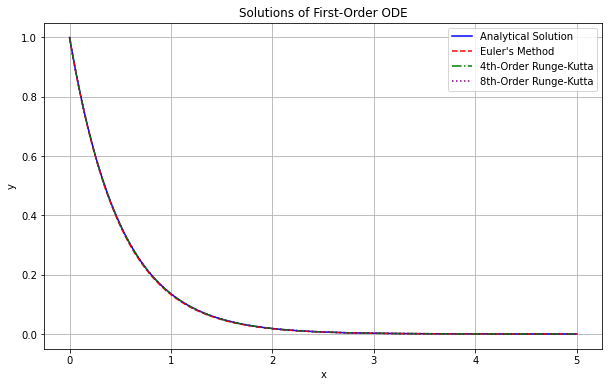

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Define the ODE: dy/dx = -2y
def differential_equation(y, x):
    return (-2 * y)

# Analytical Solution
def analytical_solution(x):
    return np.exp(-2 * x)

# Euler's Method
def euler_method(func, y0, x):
    n = len(x)
    y = np.zeros(n)
    y[0] = y0
    for i in range(1, n):
        h = x[i] - x[i-1]
        y[i] = y[i-1] + h * func(y[i-1], x[i-1])
    return y

# Fourth-Order Runge-Kutta Method
def runge_kutta_4th_order(func, y0, x):
    n = len(x)
    y = np.zeros(n)
    y[0] = y0
    for i in range(1, n):
        h = x[i] - x[i-1]
        k1 = h * func(y[i-1], x[i-1])
        k2 = h * func(y[i-1] + 0.5 * k1, x[i-1] + 0.5 * h)
        k3 = h * func(y[i-1] + 0.5 * k2, x[i-1] + 0.5 * h)
        k4 = h * func(y[i-1] + k3, x[i-1] + h)
        y[i] = y[i-1] + (k1 + 2 * k2 + 2 * k3 + k4) / 6
    return y

# Eighth-Order Runge-Kutta Method
def runge_kutta_8th_order(func, y0, x):
    n = len(x)
    y = np.zeros(n)
    y[0] = y0
    for i in range(1, n):
        h = x[i] - x[i-1]
        k1 = h * func(y[i-1], x[i-1])
        k2 = h * func(y[i-1] + 0.25 * k1, x[i-1] + 0.25 * h)
        k3 = h * func(y[i-1] + (3/32) * k1 + (9/32) * k2, x[i-1] + (3/8) * h)
        k4 = h * func(y[i-1] + (1932/2197) * k1 - (7200/2197) * k2 + (7296/2197) * k3, x[i-1] + (12/13) * h)
        k5 = h * func(y[i-1] + (439/216) * k1 - 8 * k2 + (3680/513) * k3 - (845/4104) * k4, x[i-1] + h)
        k6 = h * func(y[i-1] - (8/27) * k1 + 2 * k2 - (3544/2565) * k3 + (1859/4104) * k4 - (11/40) * k5, x[i-1] + (0.5) * h)
        y[i] = y[i-1] + (16/135) * k1 + (6656/12825) * k3 + (28561/56430) * k4 - (9/50) * k5 + (2/55) * k6
    return y

# Define the initial conditions and the range of x values
y0 = 1.0
x = np.linspace(0, 5, 500)

# Solve the ODE using different methods
analytical_result = analytical_solution(x)
euler_result = euler_method(differential_equation, y0, x)
rk4_result = runge_kutta_4th_order(differential_equation, y0, x)
rk8_result = runge_kutta_8th_order(differential_equation, y0, x)

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(x, analytical_result, label="Analytical Solution", color="blue")
plt.plot(x, euler_result, label="Euler's Method", linestyle="--", color="red")
plt.plot(x, rk4_result, label="4th-Order Runge-Kutta", linestyle="-.", color="green")
plt.plot(x, rk8_result, label="8th-Order Runge-Kutta", linestyle=":", color="purple")
plt.xlabel("x")
plt.ylabel("y")
plt.legend()
plt.title("Solutions of First-Order ODE")
plt.grid(True)
plt.show()
